In [1]:
# imports from custom library
import sys
sys.path.append('../../')
import matplotlib.pyplot as plt
from mlrefined_libraries import superlearn_library as superlearn
from mlrefined_libraries import calculus_library as callib
from mlrefined_libraries import math_optimization_library as optlib
import autograd.numpy as np
import math
import pandas as pd
from mlrefined_libraries import calculus_library as calclib

%matplotlib notebook

# this is needed to compensate for %matplotlib notebook's tendancy to blow up images when plotted inline
from matplotlib import rcParams
rcParams['figure.autolayout'] = True

%load_ext autoreload
%autoreload 2

# Part 6: Taylor series

In this post we take everything we have learned about higher order derivatives to define the *Taylor Series* of a function, a fundamental tool for mathematical optimization.

Press the botton 'Toggle code' below to toggle code on and off for entire this presentation.  

In [2]:
from IPython.display import display
from IPython.display import HTML
import IPython.core.display as di # Example: di.display_html('<h3>%s:</h3>' % str, raw=True)

# This line will hide code by default when the notebook is exported as HTML
di.display_html('<script>jQuery(function() {if (jQuery("body.notebook_app").length == 0) { jQuery(".input_area").toggle(); jQuery(".prompt").toggle();}});</script>', raw=True)

# This line will add a button to toggle visibility of code blocks, for use with the HTML export version
di.display_html('''<button onclick="jQuery('.input_area').toggle(); jQuery('.prompt').toggle();">Toggle code</button>''', raw=True)

Toggle code

- In the last few posts we described in significant detail how you can build your own Automatic Differentiator (and will have more to say about them in future posts as well).  

- However in the interest of making these posts as modular as possible, starting in this post we will often use [autorad](https://github.com/HIPS/autograd) - a free professioally built and maintained derivative calculator.

- In short, we will be using the autograd derivative calculator for many examples going forward to help make the learning of higher level concepts easier.  

#### <span style="color:#a50e3e;">Example 1. </span> A simple example illustrating how to use [autograd](https://github.com/HIPS/autograd)

Autograd is an automatic derivative calculator built to differentiate general numpy code, and mathematical functions defined by numpy code in particular.   

First we can define any math function we like - for example

\begin{equation}
g(w) = \text{tanh}(w)
\end{equation}

We express this function using numpy - or more specifically a thinly wrapped version of numpy corresponding to the autograd differentiator.

In [3]:
# import thinly wrapped numpy
import autograd.numpy as np

# define a math function
g = lambda w: np.tanh(w)

In [4]:
# import autograd Automatic Differentiator to compute the derivatives
from autograd import grad   

# compute the derivative of our input function
dgdw = grad(g)

This derivative function is something we can call just as we can the original function ```g```.

<IPython.core.display.Javascript object>


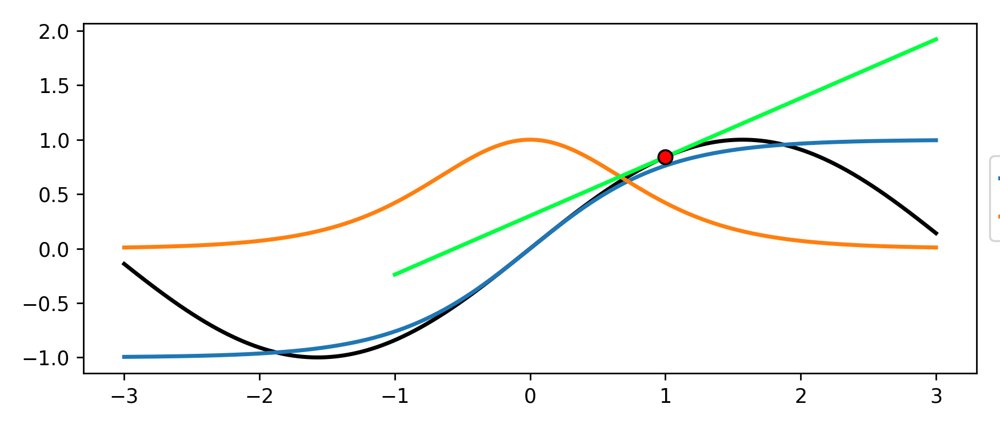

In [10]:
# define set of points over which to plot function and derivative
w = np.linspace(-3,3,2000)

# evaluate the input function g and derivative dgdw over the input points
gvals = [g(v) for v in w]
dgvals = [dgdw(v) for v in w]

# plot the function and derivative
fig = plt.figure(figsize = (7,3))
plt.plot(w,gvals,linewidth=2)
plt.plot(w,dgvals,linewidth=2)
plt.legend(['$g(w)$',r'$\frac{\mathrm{d}}{\mathrm{d}w}g(w)$'],loc='center left', bbox_to_anchor=(0, 0.5),fontsize = 13)
plt.show()

We can compute further derivatives of this input function by using the same autograd function, only this time plugging in the derivative ```dgdw```.  Doing this once gives us the second derivative.

In [5]:
# compute the second derivative of our input function
dgdw2 = grad(dgdw)

We can then plot this along with the first derivative and original function.

<IPython.core.display.Javascript object>


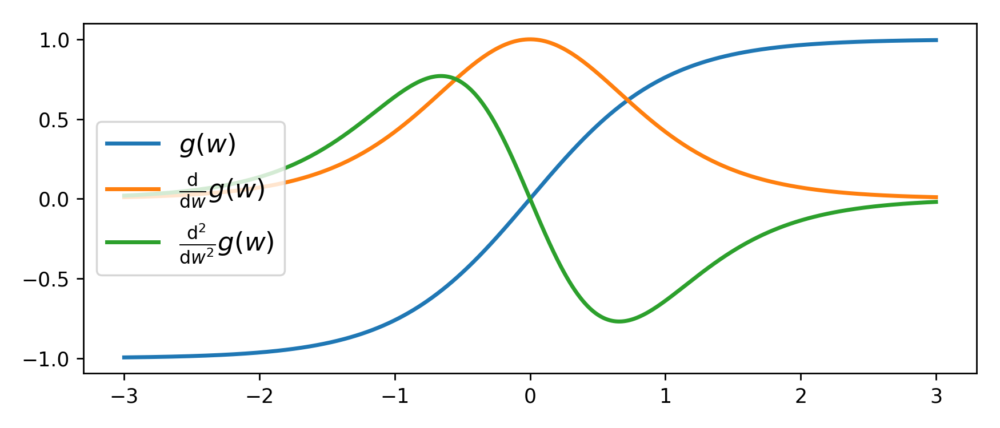

In [9]:
# define set of points over which to plot function and first two derivatives
w = np.linspace(-3,3,2000)

# evaluate the input function g, first derivative dgdw, and second derivative dgdw2 over the input points
gvals = [g(v) for v in w]
dgvals = [dgdw(v) for v in w]
dg2vals = [dgdw2(v) for v in w]

# plot the function and derivative
fig = plt.figure(figsize = (7,3))
plt.plot(w,gvals,linewidth=2)
plt.plot(w,dgvals,linewidth=2)
plt.plot(w,dg2vals,linewidth=2)
plt.legend(['$g(w)$',r'$\frac{\mathrm{d}}{\mathrm{d}w}g(w)$',r'$\frac{\mathrm{d}^2}{\mathrm{d}w^2}g(w)$'],loc='center left', bbox_to_anchor=(0, 0.5),fontsize = 13)
plt.show()

# 1.  Linear approximation is only the beginning

## 1.1  A new perspective on the tangent line

For a function $g(w)$ we then formally described the tangent line at a point $w^0$ as 

\begin{equation}
h(w) = g(w^0) + \frac{\mathrm{d}}{\mathrm{d}w}g(w^0)(w - w^0)
\end{equation}

with the slope here given by the derivative $\frac{\mathrm{d}}{\mathrm{d}w}g(w^0)$.  

<IPython.core.display.Javascript object>


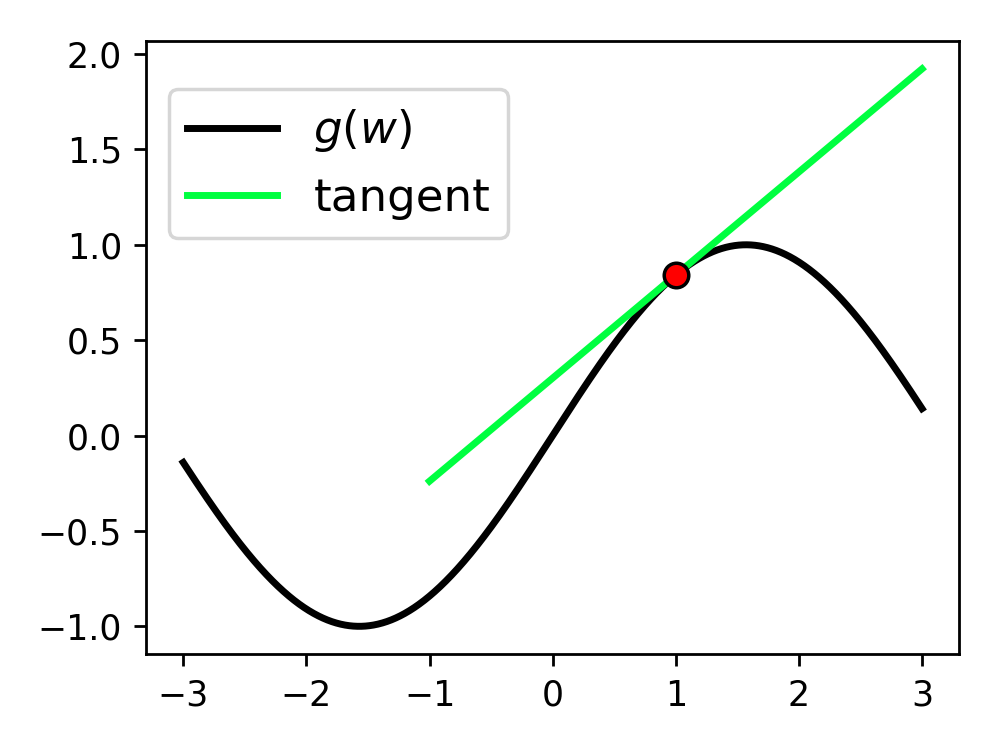

In [17]:
# create area over which to evaluate everything
w = np.linspace(-3,3,2000); w_0 = 1.0; w_=np.linspace(-2+w_0,2+w_0,2000);

# define and evaluate the function, define derivative
g = lambda w: np.sin(w); dgdw = grad(g);
gvals = [g(v) for v in w]

# create tangent line at a point w_0
tangent = g(w_0) + dgdw(w_0)*(w_ - w_0)

# plot the function and derivative 
fig = plt.figure(figsize = (4,3))
plt.plot(w,gvals,c = 'k',linewidth=2,zorder = 1)
plt.plot(w_,tangent,c = [0,1,0.25],linewidth=2,zorder = 2)
plt.scatter(w_0,g(w_0),c = 'r',s=50,zorder = 3,edgecolor='k',linewidth=1)
plt.legend(['$g(w)$','tangent'],loc='center left', bbox_to_anchor=(0, 0.8),fontsize = 13)
plt.show()

- locally (close to the point $w^0$) the tangent line looks awfully similar to the function, and so if we want to better understand $g$ near $w^0$ we can just as well look at the tangent line.  

- This makes our lives a lot easier because a line is a fairly simple object - especially when compared to an arbitrary function $g$ - and so understanding the tangent line is always a simple affair.

- notice the tangent line takes on the same value as the function $g$ at the point $w^0$.  

\begin{equation}
h(w^0) = g(w^0) + \frac{\mathrm{d}}{\mathrm{d}w}g(w^0)(w^0 - w^0) = g(w^0)
\end{equation}

- notice that the first derivative value of these two functions match as well

\begin{equation}
\frac{\mathrm{d}}{\mathrm{d}w}h(w^0) = \frac{\mathrm{d}}{\mathrm{d}w}\left (g(w^0) + \frac{\mathrm{d}}{\mathrm{d}w}g(w^0)(w - w^0)\right) = \frac{\mathrm{d}}{\mathrm{d}w}\left ( \frac{\mathrm{d}}{\mathrm{d}w}g(w^0)(w - w^0)\right) = \frac{\mathrm{d}}{\mathrm{d}w}g(w^0)
\end{equation}

In short, with the tangent line $h$ matches $g$ exactly that at $w^0$ both the function value and derivative value are equal.

\begin{array}
\
1. \,\,\, h(w^0) = g(w^0) \\
2. \,\,\, \frac{\mathrm{d}}{\mathrm{d}w}h(w^0) = \frac{\mathrm{d}}{\mathrm{d}w}g(w^0) \\
\end{array}

## 1.2  From tangent line to tangent quadratic

Likewise we can determine a simple function $h$ that matches $g$ at its second derivative value as well

\begin{array}
\
1. \,\,\, h(w^0) = g(w^0) \\
2. \,\,\, \frac{\mathrm{d}}{\mathrm{d}w}h(w^0) = \frac{\mathrm{d}}{\mathrm{d}w}g(w^0) \\
3. \,\,\, \frac{\mathrm{d}^2}{\mathrm{d}w^2}h(w^0) = \frac{\mathrm{d}^2}{\mathrm{d}w^2}g(w^0) \\
\end{array} 

This can be shown to be (see the associated post for complete details)

\begin{equation}
h(w) = g(w^0) + \frac{\mathrm{d}}{\mathrm{d}w}g(w^0)(w - w^0) +  \frac{1}{2}\frac{\mathrm{d}^2}{\mathrm{d}w^2}g(w^0)(w - w^0)^2
\end{equation}

This can be shown to be (see the associated post for complete details)

\begin{equation}
h(w) = g(w^0) + \frac{\mathrm{d}}{\mathrm{d}w}g(w^0)(w - w^0) +  \frac{1}{2}\frac{\mathrm{d}^2}{\mathrm{d}w^2}g(w^0)(w - w^0)^2
\end{equation}

This is one step beyond the tangent line - a tangent quadratic function - note that the first two terms are indeed the tangent line itself.  

<IPython.core.display.Javascript object>


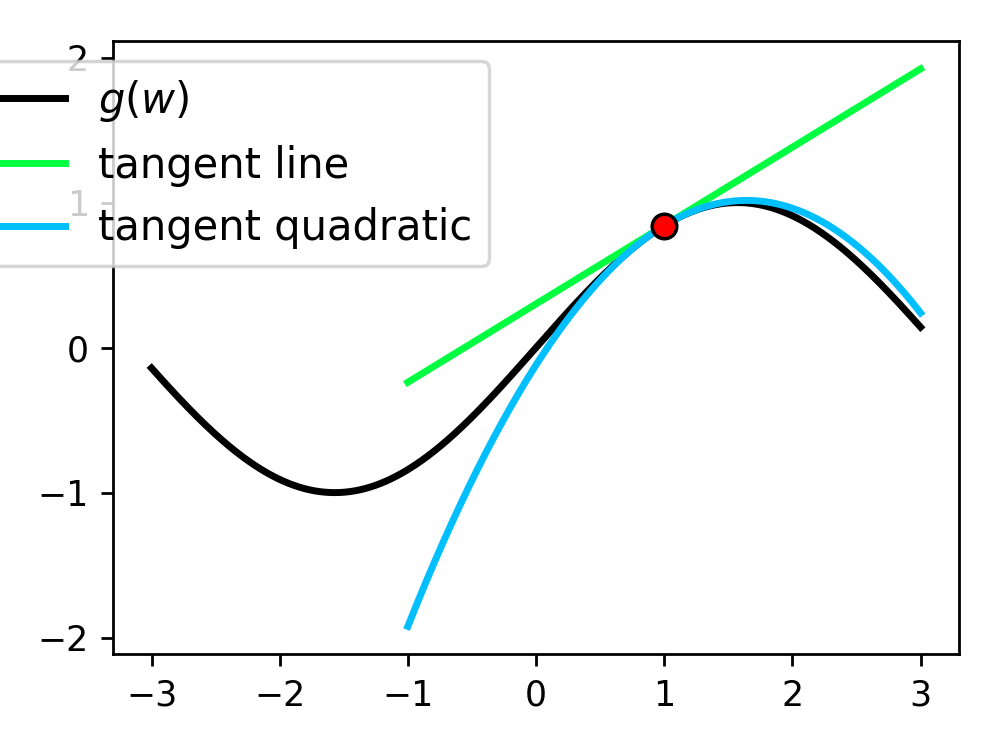

In [21]:
# create area over which to evaluate everything
w = np.linspace(-3,3,2000); w_0 = 1.0; w_=np.linspace(-2+w_0,2+w_0,2000);

# define and evaluate the function, define derivative
g = lambda w: np.sin(w); dgdw = grad(g); dgdw2 = grad(dgdw);
gvals = [g(v) for v in w]

# create tangent line and quadratic
tangent = g(w_0) + dgdw(w_0)*(w_ - w_0)
quadratic = g(w_0) + dgdw(w_0)*(w_ - w_0) + 0.5*dgdw2(w_0)*(w_ - w_0)**2

# plot the function and derivative 
fig = plt.figure(figsize = (4,3))
plt.plot(w,gvals,c = 'k',linewidth=2,zorder = 1)
plt.plot(w_,tangent,c = [0,1,0.25],linewidth=2,zorder = 2)
plt.plot(w_,quadratic,c = [0,0.75,1],linewidth=2,zorder = 2)
plt.scatter(w_0,g(w_0),c = 'r',s=50,zorder = 3,edgecolor='k',linewidth=1)
plt.legend(['$g(w)$','tangent line','tangent quadratic'],loc='center left', bbox_to_anchor=(-0.2, 0.8),fontsize = 12)
plt.show()

## 1.3  Building better and better local approximations

- is finding a simple function $h$ that satisfies even one more condition than the quadratic 

\begin{array}
\
1. \,\,\, h(w^0) = g(w^0) \\
2. \,\,\, \frac{\mathrm{d}}{\mathrm{d}w}h(w^0) = \frac{\mathrm{d}}{\mathrm{d}w}g(w^0) \\
3. \,\,\, \frac{\mathrm{d}^2}{\mathrm{d}w^2}h(w^0) = \frac{\mathrm{d}^2}{\mathrm{d}w^2}g(w^0) \\
4. \,\,\, \frac{\mathrm{d}^3}{\mathrm{d}w^3}h(w^0) = \frac{\mathrm{d}^3}{\mathrm{d}w^3}g(w^0) \\
\end{array} 

leads to the following degree 3 polynomial 

\begin{equation}
h(w) = g(w^0) + \frac{\mathrm{d}}{\mathrm{d}w}g(w^0)(w - w^0) +  \frac{1}{2}\frac{\mathrm{d}^2}{\mathrm{d}w^2}g(w^0)(w - w^0)^2 + \frac{1}{3\times2}\frac{\mathrm{d}^3}{\mathrm{d}w^3}g(w^0)(w - w^0)^3
\end{equation}

More generally setting up the corresponding set of $N+1$ criteria leads to the construction of degree $N$ polynomial

\begin{equation}
h(w^0) + g(w^0) + \sum_{n=1}^{N} \frac{1}{n!}\frac{\mathrm{d}^n}{\mathrm{d}w^n}g(w^0)(w - w^0)^n
\end{equation}

This general degree $N$ polynomial is called the **Taylor series approximation** of $g$ at the point $w^0$.  

It is *the* degree $N$ polynomial that matches $g$ as well as its first $N$ derivatives at the point $w^0$, and therefore approximates $g$ near this point better and better as we increase $N$.

> The degree $N$ polynomial $h(w^0) + g(w^0) + \sum_{n=1}^{N} \frac{1}{n!}\frac{\mathrm{d}^n}{\mathrm{d}w^n}g(w^0)(w - w^0)^n$ is called the Taylor Series of $g$ at the point $w_0$. 

We illustrate the first four Taylor Series polynomials for a user-defined input function below, animated over a range of values of the input function. 

You can use the slider to shift the point at which each approximation is made back and forth across the input range.  


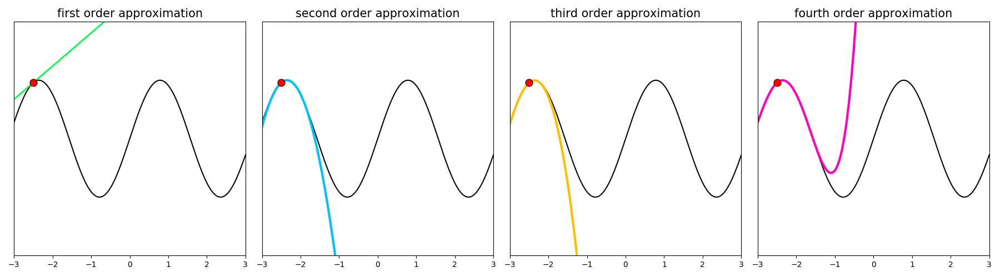
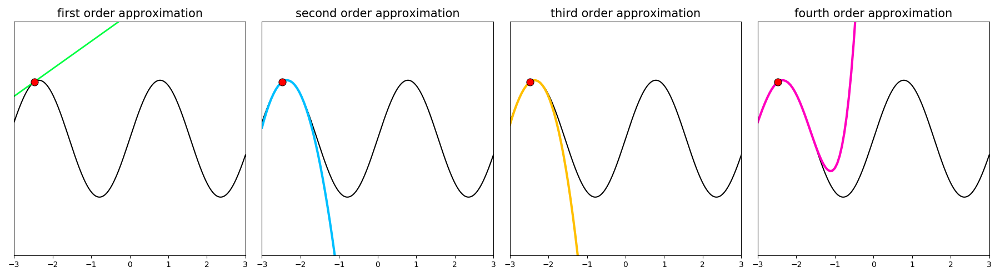
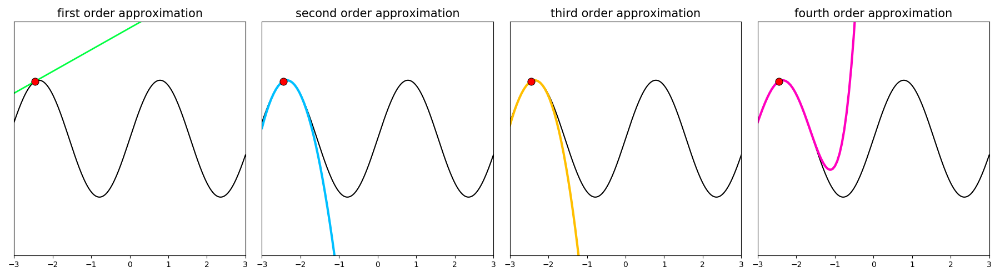
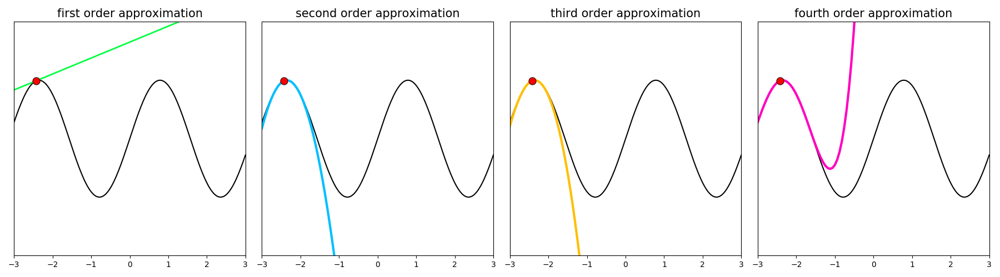
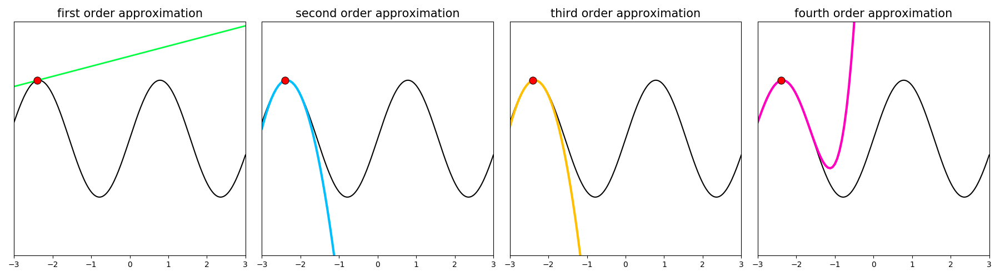
...
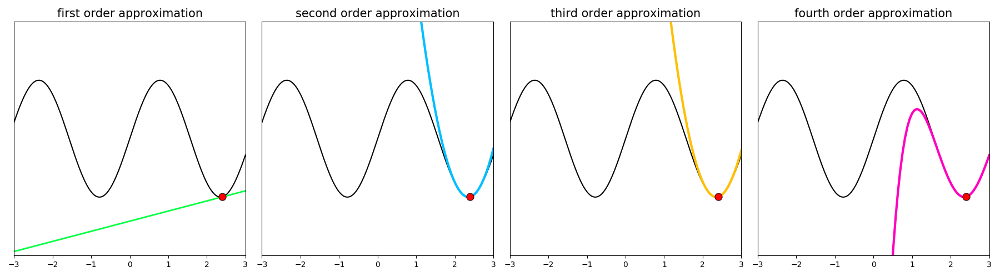
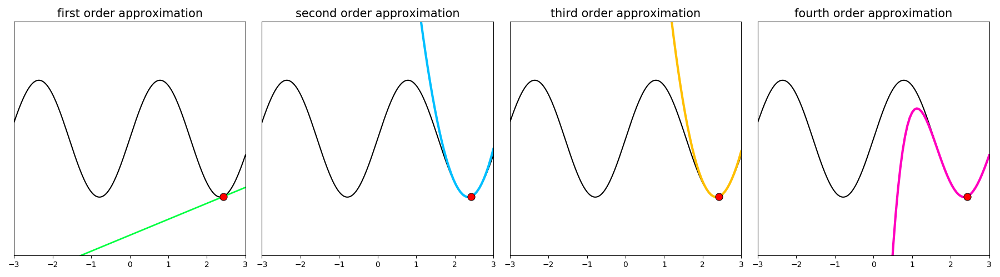
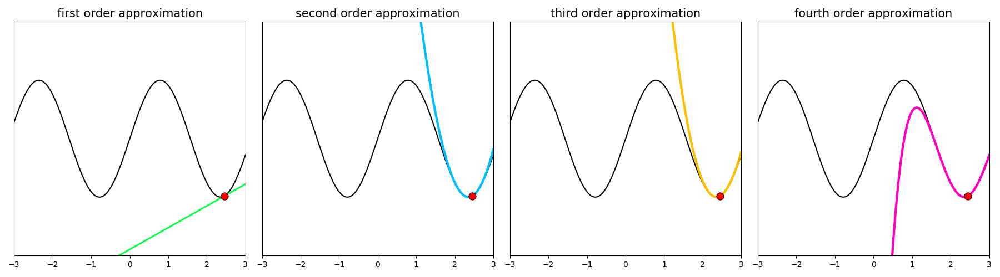
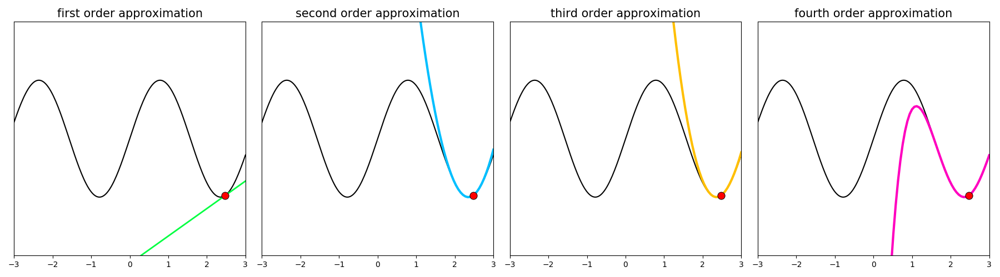
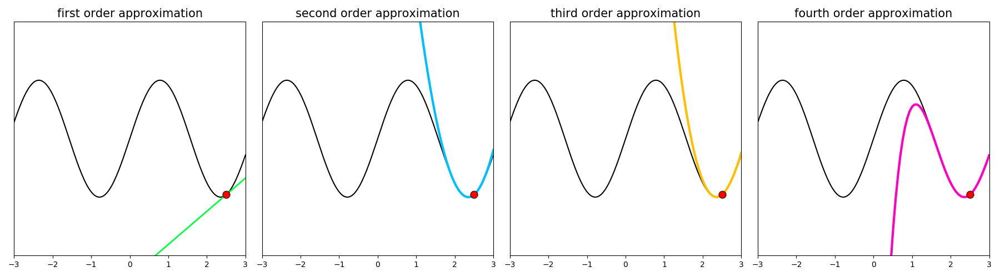

In [5]:
# what function should we play with?  Defined in the next line.
g = lambda w: np.sin(2*w)

# create an instance of the visualizer with this function 
taylor_viz = calclib.taylor_series_simultaneous_approximations.visualizer(g = g)

# run the visualizer for our chosen input function
taylor_viz.draw_it(num_frames = 200)

- the approximation becomes better and better as we increase $N$

- however it cannot match the entire function everywhere: we build each polynomial to match $g$ at only a single point $w_0$,